In [1]:
import pandas as pd

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore")

#### import healthy life expectancy data ####

In [3]:
from sql_functions import get_dataframe

In [4]:
schema = 'capstone_health_education'
sql_1 = f'SELECT * FROM {schema}.hfa_subset_healthy_life_exp'
hfa_subset_healthy_life_exp = get_dataframe(sql_1)

In [5]:
hfa_subset_healthy_life_exp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 989 entries, 0 to 988
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   country                   989 non-null    object 
 1   continent_region          989 non-null    object 
 2   year                      989 non-null    int64  
 3   school_prop_kids_not_enr  526 non-null    float64
 4   healthy_life_exp          200 non-null    float64
dtypes: float64(2), int64(1), object(2)
memory usage: 38.8+ KB


#### Import education datasets ####

In [6]:
schema = 'capstone_health_education'
sql_2 = f'SELECT * FROM {schema}.syb_education_continents'
syb_education_continents = get_dataframe(sql_2)

In [7]:
syb_education_continents.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 968 entries, 0 to 967
Data columns (total 7 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   country                                                   968 non-null    object 
 1   continent                                                 968 non-null    object 
 2   continent_region                                          968 non-null    object 
 3   year                                                      968 non-null    object 
 4   students_enrolled_in_lower_secondary_education_thousands  606 non-null    float64
 5   students_enrolled_in_primary_education_thousands          524 non-null    float64
 6   students_enrolled_in_upper_secondary_education_thousands  589 non-null    float64
dtypes: float64(3), object(4)
memory usage: 53.1+ KB


In [8]:
### changing years from object to numeric ###
syb_education_continents['year'] = syb_education_continents['year'].apply(pd.to_numeric, errors='coerce')

In [9]:
schema = 'capstone_health_education'
sql_3 = f'SELECT * FROM {schema}.pisa_r_cont_label'
pisa_r_cont_label = get_dataframe(sql_3)

In [10]:
pisa_r_cont_label.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 782 entries, 0 to 781
Data columns (total 6 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   country                782 non-null    object 
 1   continent              782 non-null    object 
 2   continent_region       782 non-null    object 
 3   year                   782 non-null    object 
 4   average_pisa_r         496 non-null    float64
 5   standard_error_pisa_r  496 non-null    float64
dtypes: float64(2), object(4)
memory usage: 36.8+ KB


In [11]:
### changing years from object to numeric ###
pisa_r_cont_label['year'] = pisa_r_cont_label['year'].apply(pd.to_numeric, errors='coerce')

In [12]:
pisa_r_cont_label['continent_region'].value_counts()

Pacific          128
South America    128
South Europe     120
Asia              96
East Europe       88
North Europe      80
West Europe       56
Middle East       32
Africa            24
North America     16
Other             14
Name: continent_region, dtype: int64

In [13]:
pisa_r_cont_label = pisa_r_cont_label[pisa_r_cont_label['continent_region'].isin(['South Europe','West Europe', 'East Europe', 'North Europe'])]

#### Merging dataframes ###

In [14]:
merged_life_exp = pd.merge(hfa_subset_healthy_life_exp, syb_education_continents, on='year', how='left')

In [15]:
merged_life_exp.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41624 entries, 0 to 41623
Data columns (total 11 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   country_x                                                 41624 non-null  object 
 1   continent_region_x                                        41624 non-null  object 
 2   year                                                      41624 non-null  int64  
 3   school_prop_kids_not_enr                                  21915 non-null  float64
 4   healthy_life_exp                                          24320 non-null  float64
 5   country_y                                                 41624 non-null  object 
 6   continent                                                 41624 non-null  object 
 7   continent_region_y                                        41624 non-null  object 
 8   students_enrolle

In [16]:
import seaborn as sns

In [17]:
#sns.pairplot(merged_life_exp)

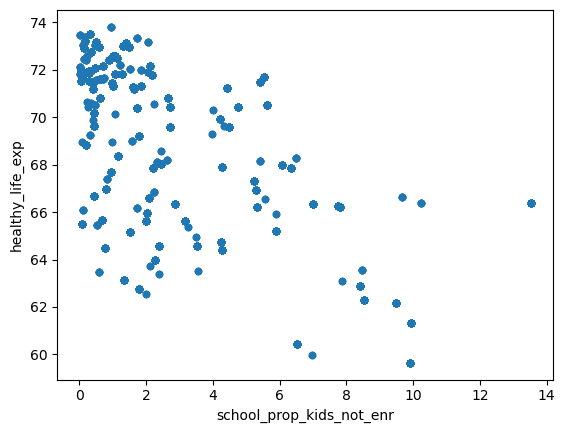

In [18]:
merged_life_exp.plot(x='school_prop_kids_not_enr', 
          y='healthy_life_exp', 
          kind='scatter');

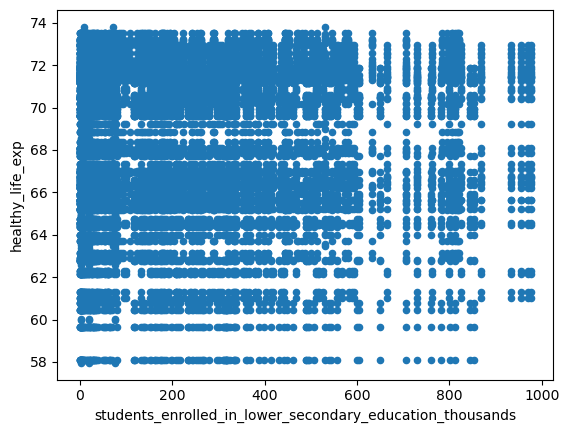

In [19]:
merged_life_exp.plot(x='students_enrolled_in_lower_secondary_education_thousands', 
          y='healthy_life_exp', 
          kind='scatter');

In [20]:
# correlation matrix between these variables
corr_columns=["school_prop_kids_not_enr","students_enrolled_in_lower_secondary_education_thousands","students_enrolled_in_upper_secondary_education_thousands", "students_enrolled_in_primary_education_thousands","healthy_life_exp"]
corr_mtrx=merged_life_exp[corr_columns].corr()
corr_mtrx

,school_prop_kids_not_enr,students_enrolled_in_lower_secondary_education_thousands,students_enrolled_in_upper_secondary_education_thousands,students_enrolled_in_primary_education_thousands,healthy_life_exp
school_prop_kids_not_enr,1.000000,-0.004012,-0.013396,0.000680,-0.585622
students_enrolled_in_lower_secondary_education_thousands,-0.004012,1.000000,0.768223,0.803176,0.001460
students_enrolled_in_upper_secondary_education_thousands,-0.013396,0.768223,1.000000,0.737053,0.017596
students_enrolled_in_primary_education_thousands,0.000680,0.803176,0.737053,1.000000,-0.006508
healthy_life_exp,-0.585622,0.001460,0.017596,-0.006508,1.000000


### merging with pisa reading ###

In [21]:
merged_life_exp_pisa_r = pd.merge (merged_life_exp, pisa_r_cont_label, on='year', how='left')

In [22]:
merged_life_exp_pisa_r.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 558140 entries, 0 to 558139
Data columns (total 16 columns):
 #   Column                                                    Non-Null Count   Dtype  
---  ------                                                    --------------   -----  
 0   country_x                                                 558140 non-null  object 
 1   continent_region_x                                        558140 non-null  object 
 2   year                                                      558140 non-null  int64  
 3   school_prop_kids_not_enr                                  383745 non-null  float64
 4   healthy_life_exp                                          372080 non-null  float64
 5   country_y                                                 558140 non-null  object 
 6   continent_x                                               558140 non-null  object 
 7   continent_region_y                                        558140 non-null  object 
 8   stud

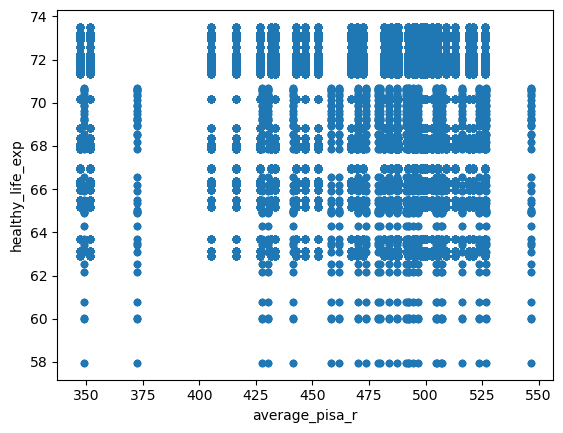

In [23]:
merged_life_exp_pisa_r.plot(x='average_pisa_r', 
          y='healthy_life_exp', 
          kind='scatter');

In [24]:
corr_columns=["school_prop_kids_not_enr","students_enrolled_in_lower_secondary_education_thousands","students_enrolled_in_upper_secondary_education_thousands", "students_enrolled_in_primary_education_thousands", "average_pisa_r","healthy_life_exp"]
corr_mtrx=merged_life_exp_pisa_r[corr_columns].corr()
corr_mtrx

,school_prop_kids_not_enr,students_enrolled_in_lower_secondary_education_thousands,students_enrolled_in_upper_secondary_education_thousands,students_enrolled_in_primary_education_thousands,average_pisa_r,healthy_life_exp
school_prop_kids_not_enr,1.000000,-0.039353,-0.029072,-0.010287,0.012650,-0.580811
students_enrolled_in_lower_secondary_education_thousands,-0.039353,1.000000,0.725338,0.821973,-0.017859,0.015637
students_enrolled_in_upper_secondary_education_thousands,-0.029072,0.725338,1.000000,0.757985,-0.005178,0.001860
students_enrolled_in_primary_education_thousands,-0.010287,0.821973,0.757985,1.000000,0.009101,-0.001205
average_pisa_r,0.012650,-0.017859,-0.005178,0.009101,1.000000,-0.000830
healthy_life_exp,-0.580811,0.015637,0.001860,-0.001205,-0.000830,1.000000


In [25]:
import matplotlib.pyplot as plt

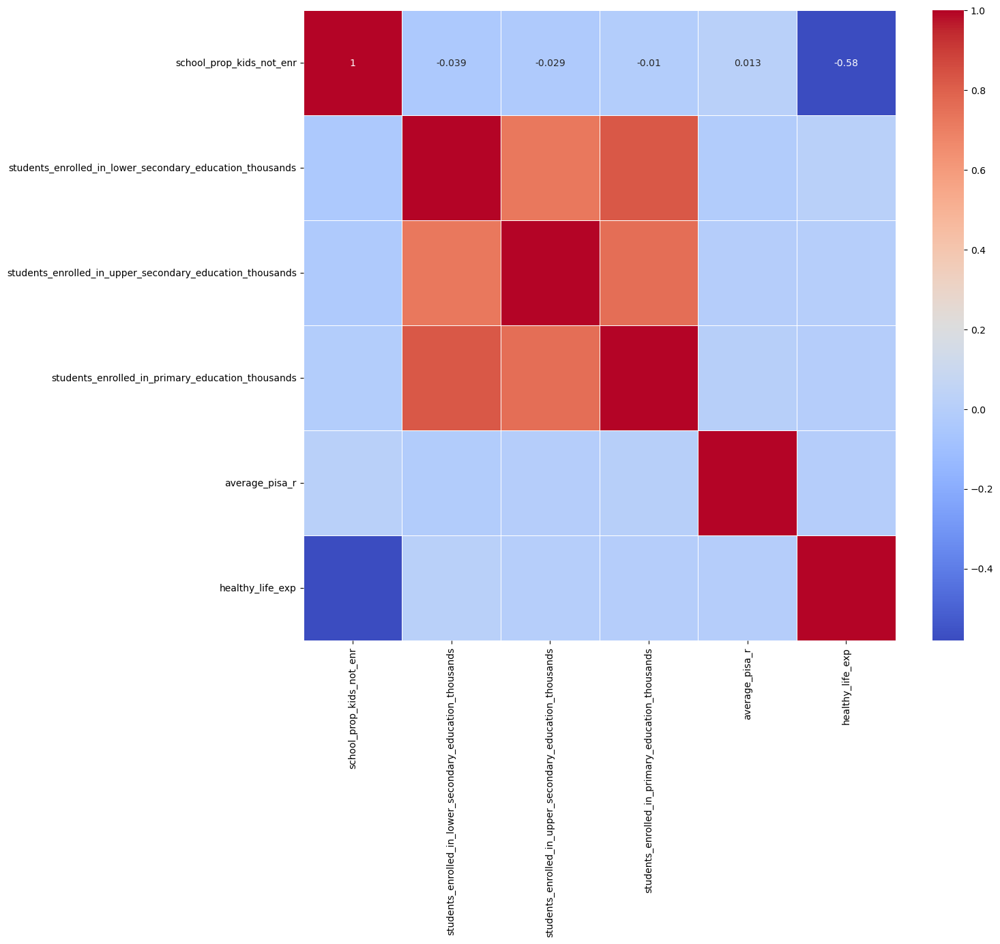

In [26]:
# draw the heatmap 
plt.figure(figsize = (14,12))
ax = sns.heatmap(corr_mtrx, linewidths=.5, annot=True, cmap='coolwarm')

### importing all health data from hfa ###

In [27]:
schema = 'capstone_health_education'
sql_4 = f'SELECT * FROM {schema}.hfa_continents'
hfa_continents = get_dataframe(sql_4)

In [28]:
hfa_continents.head()

,country,continent,continent_region,years,HFA_1,HFA_10,HFA_101,HFA_13,HFA_16,HFA_167,...,HFA_445,HFA_446,HFA_454,HFA_546,HFA_566,HFA_617,HFA_618,HFA_627,HFA_636,HFA_637
0,Albania,Europe,South Europe,2000,3114000.0,32.67,475.42,6.11,16.08,1.70,...,172.72,227.30,NaN,NaN,2.0,NaN,3.49,46.0,64.93581,28.445999
1,Albania,Europe,South Europe,2001,3069275.0,29.29,366.41,7.54,17.18,7.97,...,172.34,246.32,NaN,NaN,2.1,NaN,5.52,46.6,NaN,27.930000
2,Albania,Europe,South Europe,2002,3084150.0,28.85,397.94,7.67,14.44,7.55,...,177.56,259.42,NaN,NaN,2.2,31.7,NaN,47.3,NaN,28.143000
3,Albania,Europe,South Europe,2003,3102764.0,28.06,439.85,7.87,15.15,9.32,...,159.25,277.22,NaN,NaN,2.3,NaN,7.61,48.0,NaN,28.237000
4,Albania,Europe,South Europe,2004,3127263.0,26.90,417.70,8.21,13.76,8.74,...,150.29,278.88,NaN,NaN,2.9,NaN,8.93,48.7,NaN,28.032000


In [29]:
#sns.pairplot(hfa_continents)

In [30]:
# g = sns.PairGrid(hfa_continents)
# g.map(sns.scatterplot)

In [31]:
hfa_continents_1 = hfa_continents[['continent_region', 'HFA_618', 'HFA_617', 'HFA_566',  'HFA_194', 'HFA_260', 'HFA_357', 'HFA_417', 'HFA_446', 'HFA_636']]

In [32]:
hfa_continents_1['continent_region'].unique()

array(['South Europe', 'Asia', 'West Europe', 'East Europe', 'Other',
       'North Europe'], dtype=object)

In [33]:
hfa_continents_1 = hfa_continents_1[hfa_continents_1['continent_region'].isin(['South Europe','West Europe', 'East Europe', 'North Europe'])]

In [34]:
corr_mtrx=hfa_continents_1.corr()
corr_mtrx

,HFA_618,HFA_617,HFA_566,HFA_194,HFA_260,HFA_357,HFA_417,HFA_446,HFA_636
HFA_618,1.000000,0.090534,-0.253464,0.576433,-0.419926,-0.480270,-0.081848,0.114146,-0.573186
HFA_617,0.090534,1.000000,-0.331925,0.384242,-0.390848,-0.403462,-0.380530,0.177828,-0.315576
HFA_566,-0.253464,-0.331925,1.000000,-0.530874,0.452883,0.393579,0.370628,0.061766,0.573926
HFA_194,0.576433,0.384242,-0.530874,1.000000,-0.584412,-0.415635,-0.654185,-0.189656,-0.981684
HFA_260,-0.419926,-0.390848,0.452883,-0.584412,1.000000,0.392117,0.478420,-0.207535,0.622354
HFA_357,-0.480270,-0.403462,0.393579,-0.415635,0.392117,1.000000,-0.201956,-0.363595,0.412438
HFA_417,-0.081848,-0.380530,0.370628,-0.654185,0.478420,-0.201956,1.000000,0.157570,0.706911
HFA_446,0.114146,0.177828,0.061766,-0.189656,-0.207535,-0.363595,0.157570,1.000000,0.142997
HFA_636,-0.573186,-0.315576,0.573926,-0.981684,0.622354,0.412438,0.706911,0.142997,1.000000


#### merging with other education sources ####

In [35]:
merge_hfa1_sys_edu = pd.merge(hfa_continents_1, syb_education_continents, on='continent_region', how='left')

In [36]:
merge_hfa1_sys_edu.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 47564 entries, 0 to 47563
Data columns (total 16 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   continent_region                                          47564 non-null  object 
 1   HFA_618                                                   24686 non-null  float64
 2   HFA_617                                                   38340 non-null  float64
 3   HFA_566                                                   30848 non-null  float64
 4   HFA_194                                                   34892 non-null  float64
 5   HFA_260                                                   34700 non-null  float64
 6   HFA_357                                                   31996 non-null  float64
 7   HFA_417                                                   15590 non-null  float64
 8   HFA_446         

In [37]:
corr_mtrx=merge_hfa1_sys_edu.corr()
corr_mtrx

,HFA_618,HFA_617,HFA_566,HFA_194,HFA_260,HFA_357,HFA_417,HFA_446,HFA_636,year,students_enrolled_in_lower_secondary_education_thousands,students_enrolled_in_primary_education_thousands,students_enrolled_in_upper_secondary_education_thousands
HFA_618,1.000000,0.080466,-0.263094,0.562599,-0.406888,-0.479723,-0.055365,0.120791,-0.564628,0.002647,0.187162,0.075503,0.164179
HFA_617,0.080466,1.000000,-0.272306,0.351410,-0.375268,-0.410725,-0.338151,0.213132,-0.265567,0.000439,-0.103885,-0.083629,-0.112541
HFA_566,-0.263094,-0.272306,1.000000,-0.490199,0.409050,0.388094,0.298588,0.082358,0.539328,-0.001598,-0.089359,-0.061950,-0.063712
HFA_194,0.562599,0.351410,-0.490199,1.000000,-0.543686,-0.400422,-0.597830,-0.201134,-0.978572,0.002823,0.208216,0.121981,0.170315
HFA_260,-0.406888,-0.375268,0.409050,-0.543686,1.000000,0.393884,0.431362,-0.244363,0.587352,-0.003167,-0.057682,0.031872,-0.029607
HFA_357,-0.479723,-0.410725,0.388094,-0.400422,0.393884,1.000000,-0.199168,-0.389551,0.402107,-0.001157,0.001388,0.034301,0.010721
HFA_417,-0.055365,-0.338151,0.298588,-0.597830,0.431362,-0.199168,1.000000,0.138279,0.654124,-0.001280,-0.013270,0.000218,0.005897
HFA_446,0.120791,0.213132,0.082358,-0.201134,-0.244363,-0.389551,0.138279,1.000000,0.158244,-0.000041,-0.243329,-0.211091,-0.240857
HFA_636,-0.564628,-0.265567,0.539328,-0.978572,0.587352,0.402107,0.654124,0.158244,1.000000,-0.002835,-0.211012,-0.122717,-0.174592
year,0.002647,0.000439,-0.001598,0.002823,-0.003167,-0.001157,-0.001280,-0.000041,-0.002835,1.000000,-0.053692,-0.041146,-0.003386


In [38]:
merge_hfa1_sys_edu.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 47564 entries, 0 to 47563
Data columns (total 16 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   continent_region                                          47564 non-null  object 
 1   HFA_618                                                   24686 non-null  float64
 2   HFA_617                                                   38340 non-null  float64
 3   HFA_566                                                   30848 non-null  float64
 4   HFA_194                                                   34892 non-null  float64
 5   HFA_260                                                   34700 non-null  float64
 6   HFA_357                                                   31996 non-null  float64
 7   HFA_417                                                   15590 non-null  float64
 8   HFA_446         

In [39]:
merge_hfa1_sys_edu['year'].unique()

array([2005, 2010, 2015, 2021, 2020, 2004, 2022, 2012, 2014, 2009, 2019])

In [40]:
#sns.pairplot(merge_hfa1_sys_edu)

### adding pisa_r ###

In [50]:
merge_hfa1_sys_edu_r = pd.merge(merge_hfa1_sys_edu, pisa_r_cont_label, on='continent_region', how='left')

#### renaming labels ####

In [51]:
merge_hfa1_sys_edu_r = merge_hfa1_sys_edu_r.rename(columns={'HFA_617': 'GINI_coeff','HFA_618': 'school_nor_enr', 'HFA_194': 'all_causes_death_rate(age_stand)', 'HFA_260':'mental_nervsys_disorders_death_rate(age_stand)', 'HFA_357': 'cancer per 100000', 'HFA_417': 'SRH_good', 'HFA_446': 'FruitsVegs(kg_per_pers)', 'HFA_566': 'Total_health_exp', 'HFA_636': 'healthy_life_exp'})

In [52]:
merge_hfa1_sys_edu_r.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4700832 entries, 0 to 4700831
Data columns (total 21 columns):
 #   Column                                                    Dtype  
---  ------                                                    -----  
 0   continent_region                                          object 
 1   school_nor_enr                                            float64
 2   GINI_coeff                                                float64
 3   Total_health_exp                                          float64
 4   all_causes_death_rate(age_stand)                          float64
 5   mental_nervsys_disorders_death_rate(age_stand)            float64
 6   cancer per 100000                                         float64
 7   SRH_good                                                  float64
 8   FruitsVegs(kg_per_pers)                                   float64
 9   healthy_life_exp                                          float64
 10  country_x                     

In [55]:
corr_columns=["school_nor_enr","GINI_coeff","Total_health_exp", "all_causes_death_rate(age_stand)", "cancer per 100000", "SRH_good", "FruitsVegs(kg_per_pers)", "healthy_life_exp","students_enrolled_in_lower_secondary_education_thousands","students_enrolled_in_upper_secondary_education_thousands", "students_enrolled_in_primary_education_thousands", "average_pisa_r"]
corr_mtrx=merge_hfa1_sys_edu_r[corr_columns].corr()
corr_mtrx

,school_nor_enr,GINI_coeff,Total_health_exp,all_causes_death_rate(age_stand),cancer per 100000,SRH_good,FruitsVegs(kg_per_pers),healthy_life_exp,students_enrolled_in_lower_secondary_education_thousands,students_enrolled_in_upper_secondary_education_thousands,students_enrolled_in_primary_education_thousands,average_pisa_r
school_nor_enr,1.000000,0.072325,-0.272732,0.551047,-0.479535,-0.034431,0.124413,-0.558670,0.180134,0.165241,0.074486,-0.116461
GINI_coeff,0.072325,1.000000,-0.209569,0.319404,-0.416282,-0.289797,0.230067,-0.217971,-0.104822,-0.111964,-0.085654,-0.145109
Total_health_exp,-0.272732,-0.209569,1.000000,-0.449362,0.384320,0.214799,0.108477,0.505494,-0.111601,-0.095168,-0.069973,0.053330
all_causes_death_rate(age_stand),0.551047,0.319404,-0.449362,1.000000,-0.385365,-0.540257,-0.216682,-0.975743,0.230360,0.204352,0.131507,-0.077900
cancer per 100000,-0.479535,-0.416282,0.384320,-0.385365,1.000000,-0.202047,-0.403760,0.392447,0.010364,0.017359,0.038435,0.141976
SRH_good,-0.034431,-0.289797,0.214799,-0.540257,-0.202047,1.000000,0.135982,0.600561,-0.024849,-0.010381,-0.002177,0.105166
FruitsVegs(kg_per_pers),0.124413,0.230067,0.108477,-0.216682,-0.403760,0.135982,1.000000,0.176887,-0.252191,-0.254276,-0.209368,-0.264474
healthy_life_exp,-0.558670,-0.217971,0.505494,-0.975743,0.392447,0.600561,0.176887,1.000000,-0.232519,-0.208257,-0.131874,0.076456
students_enrolled_in_lower_secondary_education_thousands,0.180134,-0.104822,-0.111601,0.230360,0.010364,-0.024849,-0.252191,-0.232519,1.000000,0.927476,0.853316,0.080734
students_enrolled_in_upper_secondary_education_thousands,0.165241,-0.111964,-0.095168,0.204352,0.017359,-0.010381,-0.254276,-0.208257,0.927476,1.000000,0.896247,0.095936


In [66]:
corr_columns=["school_nor_enr", "all_causes_death_rate(age_stand)", "cancer per 100000", "SRH_good", "FruitsVegs(kg_per_pers)", "healthy_life_exp","students_enrolled_in_lower_secondary_education_thousands","students_enrolled_in_upper_secondary_education_thousands", "students_enrolled_in_primary_education_thousands", "average_pisa_r"]
corr_mtrx=merge_hfa1_sys_edu_r[corr_columns].corr()
corr_mtrx

,school_nor_enr,all_causes_death_rate(age_stand),cancer per 100000,SRH_good,FruitsVegs(kg_per_pers),healthy_life_exp,students_enrolled_in_lower_secondary_education_thousands,students_enrolled_in_upper_secondary_education_thousands,students_enrolled_in_primary_education_thousands,average_pisa_r
school_nor_enr,1.000000,0.551047,-0.479535,-0.034431,0.124413,-0.558670,0.180134,0.165241,0.074486,-0.116461
all_causes_death_rate(age_stand),0.551047,1.000000,-0.385365,-0.540257,-0.216682,-0.975743,0.230360,0.204352,0.131507,-0.077900
cancer per 100000,-0.479535,-0.385365,1.000000,-0.202047,-0.403760,0.392447,0.010364,0.017359,0.038435,0.141976
SRH_good,-0.034431,-0.540257,-0.202047,1.000000,0.135982,0.600561,-0.024849,-0.010381,-0.002177,0.105166
FruitsVegs(kg_per_pers),0.124413,-0.216682,-0.403760,0.135982,1.000000,0.176887,-0.252191,-0.254276,-0.209368,-0.264474
healthy_life_exp,-0.558670,-0.975743,0.392447,0.600561,0.176887,1.000000,-0.232519,-0.208257,-0.131874,0.076456
students_enrolled_in_lower_secondary_education_thousands,0.180134,0.230360,0.010364,-0.024849,-0.252191,-0.232519,1.000000,0.927476,0.853316,0.080734
students_enrolled_in_upper_secondary_education_thousands,0.165241,0.204352,0.017359,-0.010381,-0.254276,-0.208257,0.927476,1.000000,0.896247,0.095936
students_enrolled_in_primary_education_thousands,0.074486,0.131507,0.038435,-0.002177,-0.209368,-0.131874,0.853316,0.896247,1.000000,0.114665
average_pisa_r,-0.116461,-0.077900,0.141976,0.105166,-0.264474,0.076456,0.080734,0.095936,0.114665,1.000000


In [67]:
corr_columns=[ "all_causes_death_rate(age_stand)", "cancer per 100000", "SRH_good", "FruitsVegs(kg_per_pers)", "healthy_life_exp","students_enrolled_in_lower_secondary_education_thousands","students_enrolled_in_upper_secondary_education_thousands", "students_enrolled_in_primary_education_thousands"]
corr_mtrx=merge_hfa1_sys_edu_r[corr_columns].corr()
corr_mtrx

,all_causes_death_rate(age_stand),cancer per 100000,SRH_good,FruitsVegs(kg_per_pers),healthy_life_exp,students_enrolled_in_lower_secondary_education_thousands,students_enrolled_in_upper_secondary_education_thousands,students_enrolled_in_primary_education_thousands
all_causes_death_rate(age_stand),1.000000,-0.385365,-0.540257,-0.216682,-0.975743,0.230360,0.204352,0.131507
cancer per 100000,-0.385365,1.000000,-0.202047,-0.403760,0.392447,0.010364,0.017359,0.038435
SRH_good,-0.540257,-0.202047,1.000000,0.135982,0.600561,-0.024849,-0.010381,-0.002177
FruitsVegs(kg_per_pers),-0.216682,-0.403760,0.135982,1.000000,0.176887,-0.252191,-0.254276,-0.209368
healthy_life_exp,-0.975743,0.392447,0.600561,0.176887,1.000000,-0.232519,-0.208257,-0.131874
students_enrolled_in_lower_secondary_education_thousands,0.230360,0.010364,-0.024849,-0.252191,-0.232519,1.000000,0.927476,0.853316
students_enrolled_in_upper_secondary_education_thousands,0.204352,0.017359,-0.010381,-0.254276,-0.208257,0.927476,1.000000,0.896247
students_enrolled_in_primary_education_thousands,0.131507,0.038435,-0.002177,-0.209368,-0.131874,0.853316,0.896247,1.000000


In [69]:
corr_columns=["healthy_life_exp", "GINI_coeff", "all_causes_death_rate(age_stand)", "Total_health_exp"]
corr_mtrx=merge_hfa1_sys_edu_r[corr_columns].corr()
corr_mtrx

,healthy_life_exp,GINI_coeff,all_causes_death_rate(age_stand),Total_health_exp
healthy_life_exp,1.000000,-0.217971,-0.975743,0.505494
GINI_coeff,-0.217971,1.000000,0.319404,-0.209569
all_causes_death_rate(age_stand),-0.975743,0.319404,1.000000,-0.449362
Total_health_exp,0.505494,-0.209569,-0.449362,1.000000


In [58]:
merge_hfa1_sys_edu_r['GINI_coeff'].describe()

count    3.646496e+06
mean     3.089436e+01
std      4.521453e+00
min      2.090000e+01
25%      2.720000e+01
50%      3.100000e+01
75%      3.420000e+01
max      4.280000e+01
Name: GINI_coeff, dtype: float64

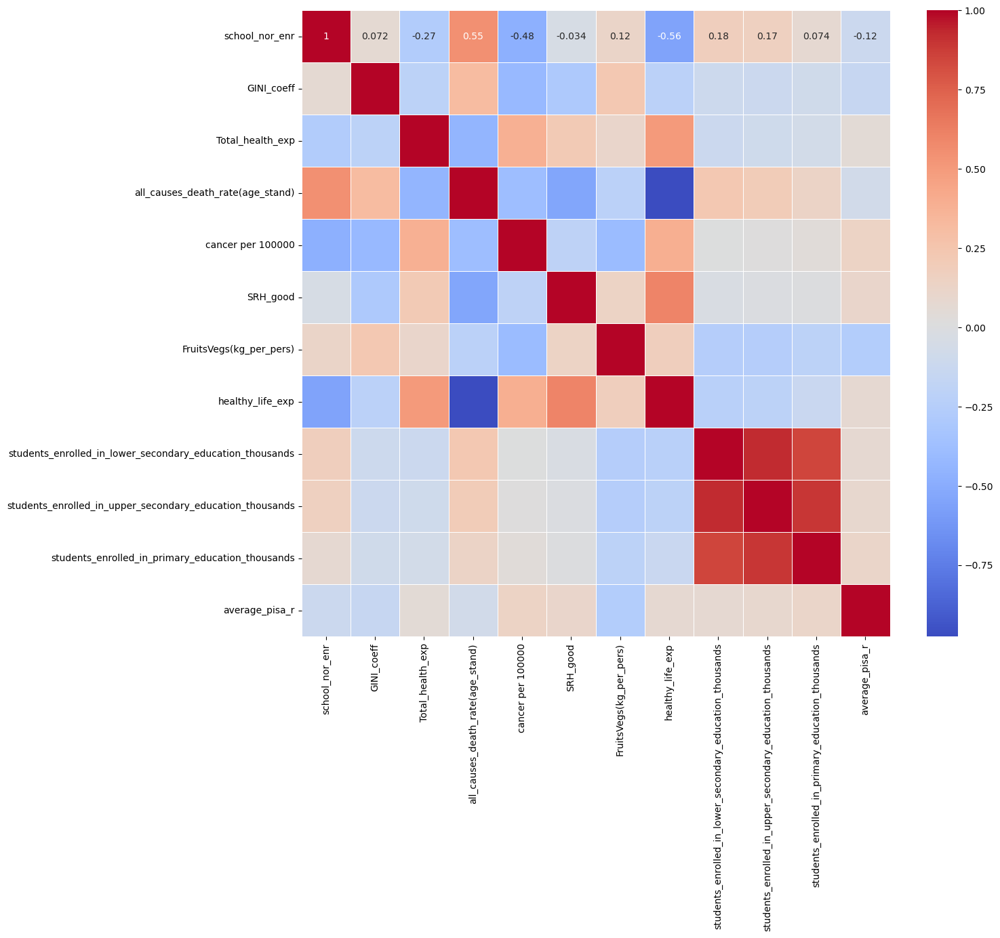

In [56]:
# draw the heatmap 
plt.figure(figsize = (14,12))
ax = sns.heatmap(corr_mtrx, linewidths=.5, annot=True, cmap='coolwarm')

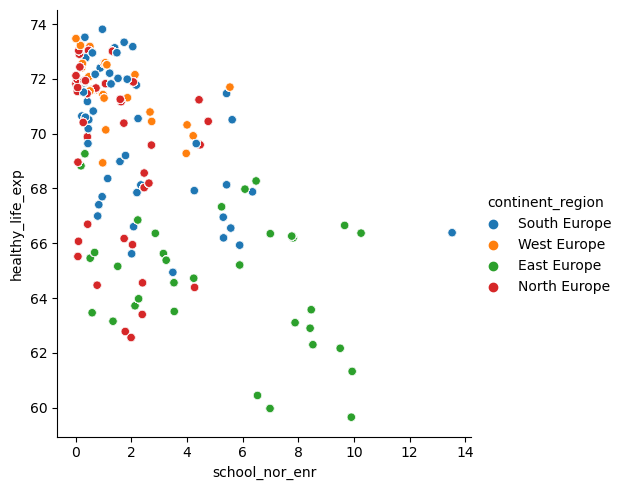

In [60]:
# scatterplot is the default type of the relplot

sns.relplot(x='school_nor_enr', y='healthy_life_exp', 
            kind='scatter', 
            hue='continent_region', data=merge_hfa1_sys_edu_r);
# relplot options are "scatter" or "line"

In [64]:
merge_hfa1_sys_edu_r['average_pisa_r'].describe()

count    3.233432e+06
mean     4.650920e+02
std      4.285571e+01
min      3.421900e+02
25%      4.428300e+02
50%      4.775700e+02
75%      4.925500e+02
max      5.468700e+02
Name: average_pisa_r, dtype: float64

In [65]:
corr_columns=["healthy_life_exp", "average_pisa_r"]
corr_mtrx=merge_hfa1_sys_edu_r[corr_columns].corr()
corr_mtrx

,healthy_life_exp,average_pisa_r
healthy_life_exp,1.000000,0.076456
average_pisa_r,0.076456,1.000000


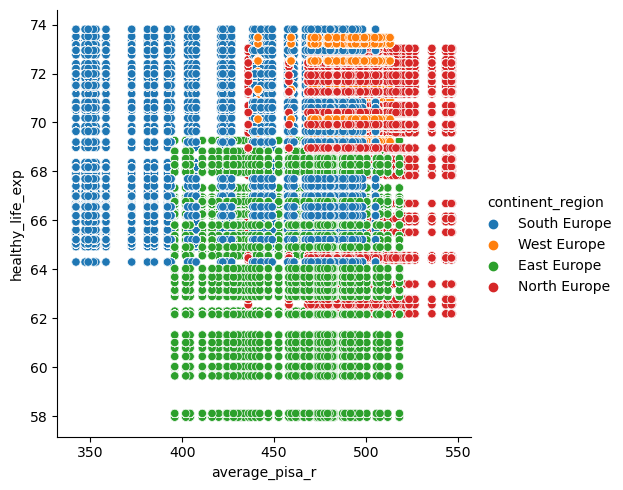

In [61]:
# scatterplot is the default type of the relplot

sns.relplot(x='average_pisa_r', y='healthy_life_exp', 
            kind='scatter', 
            hue='continent_region', data=merge_hfa1_sys_edu_r);
# relplot options are "scatter" or "line"